In [1]:
import numpy as np 
import matplotlib.pyplot as pl
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np 
import matplotlib.pyplot as pl
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from multiprocessing import Pool, cpu_count
import time

## 2D Ising Model

We simulate a $L \times L$ 2D Ising model at different temperature using the Metropolis algorithm. Each spin $\sigma_j \in \{-1, +1\}$, and the system has $2^L$ possible configurations, where $L$ is the number of lattice sites.

Hamiltonian (with external magnetic field $h$):
$$
H(\boldsymbol{\sigma}) = -J \sum_{\langle i, j \rangle} \sigma_i \sigma_j - h \sum_j \sigma_j
$$

Metropolis Algorithm:
1. Pick a random spin.
2. Compute energy difference $\Delta H$ from flipping the spin.
3. Accept the flip with probability:
   $$
   P_{\text{accept}} =
   \begin{cases}
   1 & \text{if } \Delta H \leq 0 \\
   e^{-\beta \Delta H} & \text{if } \Delta H > 0
   \end{cases}
   $$

The Balance Condition:
$$
\frac{A(\mu, \nu)}{A(\nu, \mu)} = e^{-\beta(H_\nu - H_\mu)}
$$


In [2]:
def spin_grid_animation(spin_grids, T, J, h, mu, save_path=None):


    fig, ax = pl.subplots()
    
    def update(frame):
        ax.clear()
        ax.imshow(spin_grids[frame], cmap='plasma', vmin=-1, vmax=1)
        ax.set_title(f'Spin Grid Evolution at T={T:.2f}K with h={h:.2}T outside field')
        ax.axis('off')

    ani = FuncAnimation(fig, update, frames=len(spin_grids), interval = 1)
    
    if save_path:
        ani.save(save_path, writer='imagemagick')
    
    return HTML(ani.to_jshtml())

In [3]:
class IsingModel:
    def __init__(self, grid_size, temperature, J, h, mu):
        self.grid_size = grid_size
        self.temperature = temperature
        self.spins = np.random.choice([-1, 1], size=(grid_size, grid_size))
        self.J = J  
        self.h = h
        self.mu = mu

    def energy(self):
        energy = 0
        for i in range(self.grid_size):
            for j in range(self.grid_size):
                s = self.spins[i, j]
                s_neighbors = (
                    self.spins[(i + 1) % self.grid_size, j] +
                    self.spins[i, (j + 1) % self.grid_size] +
                    self.spins[(i - 1) % self.grid_size, j] +
                    self.spins[i, (j - 1) % self.grid_size]
                )
                energy += -(1/2) * self.J * s * s_neighbors - self.h * self.mu * s

        return energy    
    
    def delta_energy(self, i, j):
        s = self.spins[i, j]
        s_neighbors = (
            self.spins[(i + 1) % self.grid_size, j] +
            self.spins[i, (j + 1) % self.grid_size] +
            self.spins[(i - 1) % self.grid_size, j] +
            self.spins[i, (j - 1) % self.grid_size]
        )
        return 2 * s * (self.J * s_neighbors + self.h * self.mu)

    def magnetization(self):
        return np.mean(self.spins)
    
    def susceptibility(self, magnetizations):
        return (np.mean(np.array(magnetizations)**2) - np.array(np.mean(magnetizations))**2) / self.temperature        
    
    def specific_heat(self, energies):
        return (np.mean(np.array(energies)**2) - np.array(np.mean(energies))**2) / (self.temperature**2)

In [4]:
def equilibrium(energies, eps, window): # az energia lista utolsó [window] darab eleménél vizsgálja, hogy mennyit változnak
    
    if len(energies) < window:
        return False
        
    recent = energies[-window:]
    diffs = np.abs(np.diff(recent))
    
    return np.all(diffs < eps )

In [5]:
def Metropolis_hastings(ising_model, steps, scalings, eps=1e-3, window=8000):

    (J_phys,  mu_phys) = scalings
    energies = []
    magnetizations = []
    
    spin_grids = []
    step = 0
    while not equilibrium(energies, eps, window) and step < steps:
            
        i, j = np.random.randint(0, ising_model.grid_size, size=2)
        delta_E = ising_model.delta_energy(i, j)

        if delta_E < 0 or np.random.rand() < np.exp(-delta_E / (ising_model.temperature)):
            ising_model.spins[i, j] *= -1

        energies.append(ising_model.energy())
        magnetizations.append(ising_model.magnetization())        

        if step % 20 == 0:
            spin_grids.append(ising_model.spins.copy())

        step += 1
        
    #print("Ennyi lepes volt:", step)
    
    #pl.plot(energies)
    #pl.show()
       
    
    E = np.mean(energies[-10:]) # az adott T-hez tartozó egyensúlyi energia
    M = np.mean(magnetizations[-10:]) # az adott T-hez tartozó egyensúlyi mágnesezettség


    #nem jó így
    #X = ising_model.susceptibility(magnetizations[-10:]) # a stabil mágnesezettségekből számolt szuszceptibilitás
    #C = ising_model.specific_heat(energies[-10:]) # a stabil energiákból számolt fajhő

    return E * J_phys, M * mu_phys, np.array(spin_grids) #vmi dimenziósító szorzó kéne a szuszceptibilitásnak meg fajhőnek

In [6]:
def plot(T, energies, magnetization, susceptibility, specific_heat):
    
    f = pl.figure(figsize=(18, 10))
    
    sp =  f.add_subplot(2, 2, 1)
    pl.scatter(T, energies, s=50, marker='o', color='IndianRed')
    pl.xlabel("Temperature", fontsize=20)
    pl.ylabel("Energy ", fontsize=20)         
    pl.axis('tight')
    
    sp =  f.add_subplot(2, 2, 2)
    pl.scatter(T, abs(magnetization), s=50, marker='o', color='RoyalBlue')
    pl.xlabel("Temperature", fontsize=20) 
    pl.ylabel("Magnetization ", fontsize=20)   
    pl.axis('tight')
    
    sp =  f.add_subplot(2, 2, 3)
    pl.scatter(T, susceptibility, s=50, marker='o', color='IndianRed')
    pl.xlabel("Temperature", fontsize=20)  
    pl.ylabel("Specific Heat ", fontsize=20)   
    pl.axis('tight')   
    
    sp =  f.add_subplot(2, 2, 4)
    pl.scatter(T, specific_heat, s=50, marker='o', color='RoyalBlue')
    pl.xlabel("Temperature", fontsize=20)
    pl.ylabel("Susceptibility", fontsize=20) 
    pl.axis('tight')

MovieWriter imagemagick unavailable; using Pillow instead.
Animation size has reached 20978975 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


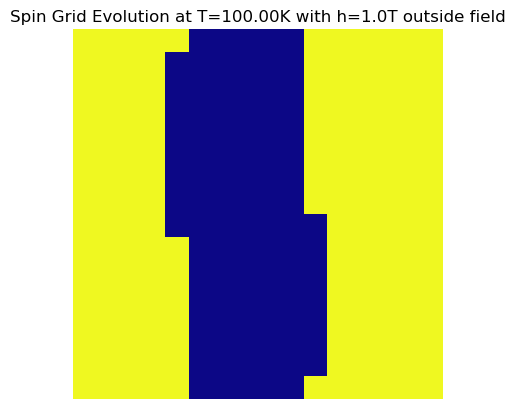

In [7]:
k_B = 1.380649e-23       # J/K
J_phys = 2.0e-21         # J
mu_phys = 9.2740100783e-24      # J/T
T_phys = 100             # K
h_phys = 1.0             # T


T = T_phys * (k_B / J_phys)         # 1
h = h_phys * (mu_phys / J_phys)     # 1
J = 1.0                              
mu = 1.0  


ising_model = IsingModel(grid_size=16, temperature=T, J=J, h=h, mu=mu)

steps = 50000
scalings = (J_phys, mu_phys)
energies, magnetizations, spin_grids = Metropolis_hastings(ising_model, steps, scalings)



path = r'D:\Egyetem\Tudományos Programozás\Ising_model_simulation\plots_and_animations\ising_model_animation_270K.gif'
spin_grid_animation(spin_grids, T_phys, J_phys, h_phys, mu_phys, save_path=path)

In [8]:
print(energies)

-8.806120846651685e-19


MovieWriter imagemagick unavailable; using Pillow instead.
Animation size has reached 20981141 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


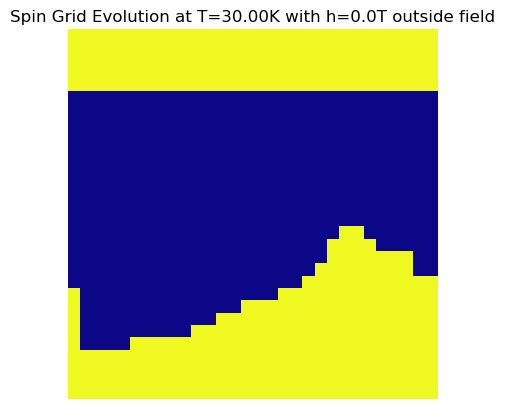

In [9]:
k_B = 1.380649e-23       # J/K
J_phys = 2.0e-21         # J
mu_phys = 9.2740100783e-24      # J/T
T_phys = 30             # K
h_phys = 0.            # T


T = T_phys * (k_B / J_phys)         # 1
h = h_phys * (mu_phys / J_phys)     # 1
J = 1.0                              
mu = 0.


ising_model = IsingModel(grid_size=30, temperature=T, J=J, h=h, mu=mu)

steps = 50000
scalings = (J_phys, mu_phys)
energies, magnetizations, spin_grids = Metropolis_hastings(ising_model, steps, scalings)

path = r'D:\Egyetem\Tudományos Programozás\Ising_model_simulation\plots_and_animations\\ising_model_animation_56.gif'
spin_grid_animation(spin_grids, T_phys, J_phys, h_phys, mu_phys, save_path=path)

In [10]:
class IsingModelOptimized:
    def __init__(self, grid_size, temperature, J, h, mu):
        self.grid_size = grid_size
        self.temperature = temperature
        self.spins = np.random.choice([-1, 1], size=(grid_size, grid_size))
        self.J = J  
        self.h = h
        self.mu = mu
        # Track current energy to avoid recalculation
        self.current_energy = self._calculate_initial_energy()

    def _calculate_initial_energy(self):
        """Calculate energy once at initialization"""
        energy = 0
        for i in range(self.grid_size):
            for j in range(self.grid_size):
                s = self.spins[i, j]
                # Count each pair only once (right and down neighbors)
                right = self.spins[(i + 1) % self.grid_size, j]
                down = self.spins[i, (j + 1) % self.grid_size]
                energy += -self.J * s * (right + down) - 0.5 * self.h * self.mu * s
        return energy

    def delta_energy(self, i, j):
        s = self.spins[i, j]
        s_neighbors = (
            self.spins[(i + 1) % self.grid_size, j] +
            self.spins[i, (j + 1) % self.grid_size] +
            self.spins[(i - 1) % self.grid_size, j] +
            self.spins[i, (j - 1) % self.grid_size]
        )
        return 2 * s * (self.J * s_neighbors + self.h * self.mu)

    def magnetization(self):
        return np.sum(self.spins) / (self.grid_size * self.grid_size)

    def flip_spin(self, i, j, delta_E):
        """Flip spin and update energy"""
        self.spins[i, j] *= -1
        self.current_energy += delta_E

In [11]:
def equilibrium_optimized(energies, eps, window):
    """Optimized equilibrium check with relative tolerance"""
    if len(energies) < window:
        return False
        
    recent = energies[-window:]
    mean_energy = np.mean(recent)
    if abs(mean_energy) < 1e-10:  # Avoid division by zero
        return np.std(recent) < eps
    
    # Use relative change criterion
    relative_std = np.std(recent) / abs(mean_energy)
    return relative_std < eps

In [12]:
def Metropolis_hastings_optimized(ising_model, steps, scalings, eps=1e-4, window=500):
    """Optimized Metropolis algorithm with energy tracking"""
    J_phys, mu_phys = scalings
    energies = []
    magnetizations = []
    spin_grids = []
    
    beta = 1.0 / ising_model.temperature
    grid_size_sq = ising_model.grid_size * ising_model.grid_size
    
    # Pre-calculate exponentials for common delta_E values (performance boost)
    exp_cache = {}
    
    step = 0
    equilibrium_check_interval = 100  # Check equilibrium less frequently
    
    while step < steps:
        # Perform multiple MC steps before checks
        for _ in range(min(equilibrium_check_interval, steps - step)):
            i, j = np.random.randint(0, ising_model.grid_size, size=2)
            delta_E = ising_model.delta_energy(i, j)

            # Use cached exponentials for performance
            if delta_E < 0:
                accept = True
            else:
                if delta_E not in exp_cache:
                    exp_cache[delta_E] = np.exp(-delta_E * beta)
                accept = np.random.rand() < exp_cache[delta_E]
            
            if accept:
                ising_model.flip_spin(i, j, delta_E)

            # Store measurements less frequently during equilibration
            if step < window * 2:  # During equilibration
                if step % 10 == 0:
                    energies.append(ising_model.current_energy)
                    magnetizations.append(ising_model.magnetization())
            else:  # After equilibration
                energies.append(ising_model.current_energy)
                magnetizations.append(ising_model.magnetization())
            
            if step % 50 == 0:  # Store grids less frequently
                spin_grids.append(ising_model.spins.copy())

            step += 1
            
        # Check equilibrium less frequently
        if step > window and step % equilibrium_check_interval == 0:
            if equilibrium_optimized(energies, eps, window):
                break
    
    # Use smaller sample for final averages (last 50 instead of 100)
    sample_size = min(50, len(energies) // 4)
    E = np.mean(energies[-sample_size:])
    M = np.mean(magnetizations[-sample_size:])
    
    return E * J_phys, M * mu_phys, np.array(spin_grids), energies, magnetizations

In [13]:
def single_temperature_simulation(args):
    """Single temperature simulation for multiprocessing"""
    T_val, grid_size, J, h, mu, steps, scalings, N, eps, window = args
    
    E_sum = M_sum = E2_sum = M2_sum = 0
    
    for run in range(N):
        # Create fresh model for each run
        ising_model = IsingModelOptimized(grid_size, T_val, J, h, mu)
        
        E, M, _, energies, magnetizations = Metropolis_hastings_optimized(
            ising_model, steps, scalings, eps, window
        )
        
        # Use equilibrium values for statistics (last 20% of data)
        eq_start = max(len(energies) // 5 * 4, len(energies) - 30)
        E_eq = np.mean(energies[eq_start:])
        M_eq = np.mean(magnetizations[eq_start:])
        
        E_sum += E_eq
        M_sum += M_eq
        E2_sum += E_eq * E_eq
        M2_sum += M_eq * M_eq
    
    # Calculate ensemble averages
    n = 1.0 / N
    avg_E = E_sum * n
    avg_M = M_sum * n
    avg_E2 = E2_sum * n
    avg_M2 = M2_sum * n
    
    # Thermodynamic quantities
    rT = 1.0 / T_val
    specific_heat = (avg_E2 - avg_E * avg_E) * rT * rT
    susceptibility = (avg_M2 - avg_M * avg_M) * rT
    
    return avg_E, avg_M, specific_heat, susceptibility

In [14]:
def parallel_temperature_sweep_optimized():
    """Optimized parallel temperature sweep"""
    k_B = 1.380649e-23       # J/K
    J_phys = 2.0e-21         # J
    mu_phys = 9.2740100783e-24      # J/T
    
    # Optimized parameters
    nT = 1  # Reasonable number of temperature points
    T_phys = np.linspace(50, 200, nT)             # K
    h_phys = 0.0             # T
    
    T = T_phys * (k_B / J_phys)         # Dimensionless temperature
    h = h_phys * (mu_phys / J_phys)     # Dimensionless field
    J = 1.0                              
    mu = 1.0  
    
    # Optimized simulation parameters
    steps = 1500    # Reduced from 30000
    N = 50           # Reduced from 1000 - still gives good statistics
    grid_size = 16   # Slightly larger grid for better physics
    eps = 1e-4       # Equilibrium tolerance
    window = 1000     # Smaller equilibrium window
    
    scalings = (J_phys, mu_phys)
    
    # Prepare arguments for multiprocessing
    args_list = [
        (T[kT], grid_size, J, h, mu, steps, scalings, N, eps, window) 
        for kT in range(nT)
    ]
    
    print(f"Starting parallel simulation with {cpu_count()} cores...")
    start_time = time.time()
    
    # Use multiprocessing with optimal number of processes
    n_processes = min(cpu_count(), nT)
    with Pool(processes=n_processes) as pool:
        results = pool.map(single_temperature_simulation, args_list)
    
    end_time = time.time()
    print(f"Simulation completed in {end_time - start_time:.2f} seconds")
    
    # Unpack results
    energies = np.array([r[0] for r in results])
    magnetizations = np.array([r[1] for r in results])
    specific_heat = np.array([r[2] for r in results])
    susceptibility = np.array([r[3] for r in results])
    
    return T_phys, energies, magnetizations, specific_heat, susceptibility

In [15]:
def plot_optimized(T, energies, magnetization, susceptibility, specific_heat):
    """Enhanced plotting function"""
    f = pl.figure(figsize=(16, 12))
    
    # Energy plot
    sp = f.add_subplot(2, 2, 1)
    pl.plot(T, energies, 'o-', color='IndianRed', markersize=4, linewidth=1.5)
    pl.xlabel("Temperature (K)", fontsize=14)
    pl.ylabel("Energy per site (J)", fontsize=14)         
    pl.grid(True, alpha=0.3)
    pl.title("Average Energy vs Temperature", fontsize=14)
    
    # Magnetization plot
    sp = f.add_subplot(2, 2, 2)
    pl.plot(T, np.abs(magnetization), 'o-', color='RoyalBlue', markersize=4, linewidth=1.5)
    pl.xlabel("Temperature (K)", fontsize=14) 
    pl.ylabel("|Magnetization| (J/T)", fontsize=14)   
    pl.grid(True, alpha=0.3)
    pl.title("Magnetization vs Temperature", fontsize=14)
    
    # Specific Heat plot
    sp = f.add_subplot(2, 2, 3)
    pl.plot(T, specific_heat, 'o-', color='Green', markersize=4, linewidth=1.5)
    pl.xlabel("Temperature (K)", fontsize=14)  
    pl.ylabel("Specific Heat (J/K²)", fontsize=14)   
    pl.grid(True, alpha=0.3)
    pl.title("Specific Heat vs Temperature", fontsize=14)
    
    # Susceptibility plot
    sp = f.add_subplot(2, 2, 4)
    pl.plot(T, susceptibility, 'o-', color='Purple', markersize=4, linewidth=1.5)
    pl.xlabel("Temperature (K)", fontsize=14)
    pl.ylabel("Susceptibility (J/T²K)", fontsize=14) 
    pl.grid(True, alpha=0.3)
    pl.title("Magnetic Susceptibility vs Temperature", fontsize=14)
    
    pl.tight_layout()
    pl.show()
    
    # Print critical temperature estimate
    max_C_idx = np.argmax(specific_heat)
    max_X_idx = np.argmax(susceptibility)
    print(f"Critical temperature estimates:")
    print(f"From specific heat peak: T_c ≈ {T[max_C_idx]:.1f} K")
    print(f"From susceptibility peak: T_c ≈ {T[max_X_idx]:.1f} K")

In [ ]:
T_phys, energies, magnetizations, specific_heat, susceptibility = parallel_temperature_sweep_optimized()
    
# Plot results with enhanced visualization
plot_optimized(T_phys, energies, magnetizations, susceptibility, specific_heat)    

Starting parallel simulation with 6 cores...


In [ ]:
k_B = 1.380649e-23       # J/K
J_phys = 2.0e-21         # J
mu_phys = 9.2740100783e-24      # J/T

nT = 100 # hőmérséklet adatpontok száma
T_phys = np.linspace(50, 200, nT)             # K
h_phys = 1.0             # T


T = T_phys * (k_B / J_phys)         # 1
h = h_phys * (mu_phys / J_phys)     # 1
J = 1.0                              
mu = 1.0  


steps = 30000
scalings = (J_phys, mu_phys)
N = 1000 # egy hőmérsékleten hány szimulációból átlagolja az eredményeket 
n = 1.0 / N
n2 = n * n

energies, magnetization, susceptibility, specific_heat = np.zeros(nT), np.zeros(nT), np.zeros(nT), np.zeros(nT)

for kT in range(nT):
    ising_model = IsingModel(grid_size=10, temperature=T[kT], J=J, h=h, mu=mu)
    E1 = M1 = E2 = M2 = 0
    rT = 1.0 / T[kT]
    rT2 = rT * rT
    for i in range(N):
        E, M, spin_grids = Metropolis_hastings(ising_model, steps, scalings)
        E1 = E1 + E
        M1 = M1 + M
        M2 = M2 + M * M 
        E2 = E2 + E * E

    energies[kT] = E1 * n
    magnetization[kT] = M * n
    specific_heat[kT] = (E2 * n - E1 * E1 * n2) * rT2
    susceptibility[kT] = (M2 * n - M1 * M1 * n2) * rT

KeyboardInterrupt: 

In [ ]:
plot(T, energies, magnetization, susceptibility, specific_heat)

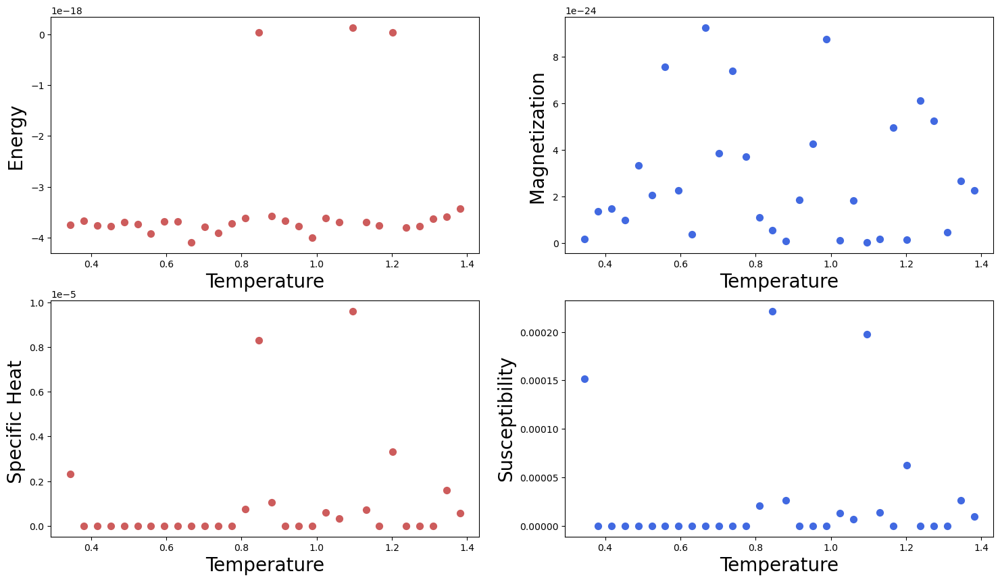

In [ ]:
a=[2324, 32423, 324,24,423, 23,33,43,4]
pl.plot(a)
pl.show()

In [ ]:
def equilibrium(energies, eps, window): # az energia lista utolsó [window] darab eleménél vizsgálja, hogy mennyit változnak
    
    if len(energies) < window:
        return False
        
    recent = energies[-window:]
    #print('recent', recent)
    diffs = np.abs(np.diff(recent))
    #print('diffs',diffs)
    
    return np.all(diffs < eps * energies[-1])

In [ ]:
from math import factorial
import numpy as np
a=[]
n=0
e=0
while not equilibrium(a, 1e-3, 10) and n<21:
    print(e)
    
    e+=1.0/factorial(n)
    a.append(e)
    n+=1
print(n)
print(a)
    

0
1.0
2.0
2.5
2.6666666666666665
2.708333333333333
2.7166666666666663
2.7180555555555554
2.7182539682539684
2.71827876984127
2.7182815255731922
2.7182818011463845
2.718281826198493
2.7182818282861687
2.7182818284467594
15
[1.0, 2.0, 2.5, 2.6666666666666665, 2.708333333333333, 2.7166666666666663, 2.7180555555555554, 2.7182539682539684, 2.71827876984127, 2.7182815255731922, 2.7182818011463845, 2.718281826198493, 2.7182818282861687, 2.7182818284467594, 2.71828182845823]


In [ ]:

e=2.718281828459045235360287471352662497

120